### TODO
1. Należy sprawdzić wartości specjalne - bardzo wysokie wartości i zdecydować co z nimi zrobić.

2. Należy sprawdzić które cechy można zaniedbać ze względu na zbyt małą istotność - w małym stopniu wpływają na wynik.

3. Dodać pipeline dokonujący one-hot coding.

4. Należy znaleźć moduł w pipeline, który sam dopasowuje liczbę cech wejściowych.

5. Jeżeli normalizacja wejściowa w lesie losowym jest bezużyteczna, to jej nie robić.

6. Macierz pomyłek (dla skwantowanych wartości), znaleźć wskaźniki jakości modelu regresu.

### imports

In [1]:
import os
import pandas as pd
import folium
from folium.plugins import MarkerCluster
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from zlib import crc32
import random
import seaborn as sns

from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
import xgboost as xgb
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR


### 1. Fetch data

In [2]:
"""
Fetch .csv data from directories.
"""

csv_path = os.path.join('data')
all_files = os.listdir(csv_path)
csv_files = [f for f in all_files if f.count('rent') == 0 and f.count('.csv') == 1] # if you want rent-apartments, set 1 instad 0
df_list = []

for csv in csv_files:
    file_path = os.path.join(csv_path, csv)
    try:
        # Try reading the file using default UTF-8 encoding
        df = pd.read_csv(file_path)
        df_list.append(df)
    except Exception as e:
        print(f"Could not read file {csv}, error: {e}")

data = pd.concat(df_list, ignore_index=True)

print(f"Samples amount: {len(data)}")
data.head()

Samples amount: 134577


,id,city,type,squareMeters,rooms,floor,floorCount,buildYear,latitude,longitude,...,pharmacyDistance,ownership,buildingMaterial,condition,hasParkingSpace,hasBalcony,hasElevator,hasSecurity,hasStorageRoom,price
0,f8524536d4b09a0c8ccc0197ec9d7bde,szczecin,blockOfFlats,63.00,3.0,4.0,10.0,1980.0,53.378933,14.625296,...,0.413,condominium,concreteSlab,NaN,yes,yes,yes,no,yes,415000
1,accbe77d4b360fea9735f138a50608dd,szczecin,blockOfFlats,36.00,2.0,8.0,10.0,NaN,53.442692,14.559690,...,0.205,cooperative,concreteSlab,NaN,no,yes,yes,no,yes,395995
2,8373aa373dbc3fe7ca3b7434166b8766,szczecin,tenement,73.02,3.0,2.0,3.0,NaN,53.452222,14.553333,...,0.280,condominium,brick,NaN,no,no,no,no,no,565000
3,0a68cd14c44ec5140143ece75d739535,szczecin,tenement,87.60,3.0,2.0,3.0,NaN,53.435100,14.532900,...,0.087,condominium,brick,NaN,yes,yes,no,no,yes,640000
4,f66320e153c2441edc0fe293b54c8aeb,szczecin,blockOfFlats,66.00,3.0,1.0,3.0,NaN,53.410278,14.503611,...,0.514,condominium,NaN,NaN,no,no,no,no,no,759000


### 2. Data cleaning

In [3]:
"""
Check data type.
"""

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134577 entries, 0 to 134576
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    134577 non-null  object 
 1   city                  134577 non-null  object 
 2   type                  104834 non-null  object 
 3   squareMeters          134577 non-null  float64
 4   rooms                 134577 non-null  float64
 5   floor                 110315 non-null  float64
 6   floorCount            132816 non-null  float64
 7   buildYear             112014 non-null  float64
 8   latitude              134577 non-null  float64
 9   longitude             134577 non-null  float64
 10  centreDistance        134577 non-null  float64
 11  poiCount              134577 non-null  float64
 12  schoolDistance        134438 non-null  float64
 13  clinicDistance        134029 non-null  float64
 14  postOfficeDistance    134388 non-null  float64
 15  

In [4]:
"""
Clean NaN and duplicates. Drop columns with lack of data.
"""

dropped_columns = ['id','type', 'floor', 'buildYear', 'condition', 'buildingMaterial']
data.drop(dropped_columns, axis=1, inplace=True)
data.dropna(inplace=True)
data = data.drop_duplicates().reset_index(drop=True)

In [5]:
"""
Check number of null values.
"""

print(f"Dataset amount: {len(data)}")
data.isna().sum()

Dataset amount: 66443


city                    0
squareMeters            0
rooms                   0
floorCount              0
latitude                0
longitude               0
centreDistance          0
poiCount                0
schoolDistance          0
clinicDistance          0
postOfficeDistance      0
kindergartenDistance    0
restaurantDistance      0
collegeDistance         0
pharmacyDistance        0
ownership               0
hasParkingSpace         0
hasBalcony              0
hasElevator             0
hasSecurity             0
hasStorageRoom          0
price                   0
dtype: int64

### 3. Analize cleared data

In [6]:
"""
Statistics.
"""

data.describe()

,squareMeters,rooms,floorCount,latitude,longitude,centreDistance,poiCount,schoolDistance,clinicDistance,postOfficeDistance,kindergartenDistance,restaurantDistance,collegeDistance,pharmacyDistance,price
count,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,66443.000000,6.644300e+04
mean,57.114249,2.626432,5.487967,51.975536,19.555433,4.416842,19.964090,0.390295,0.944420,0.489531,0.336887,0.323454,1.487795,0.334055,7.555741e+05
std,20.470559,0.890118,3.368798,1.307263,1.751306,2.765013,22.605896,0.381339,0.840503,0.410129,0.349058,0.369218,1.112050,0.364922,3.876505e+05
min,25.000000,1.000000,1.000000,49.982200,14.462282,0.020000,0.000000,0.002000,0.001000,0.001000,0.001000,0.001000,0.006000,0.001000,1.512000e+05
25%,43.000000,2.000000,3.000000,51.104316,18.549664,2.190000,7.000000,0.176000,0.359000,0.238000,0.152000,0.116000,0.604500,0.144000,5.090000e+05
50%,53.200000,3.000000,4.000000,52.193514,19.931398,4.080000,14.000000,0.289000,0.678000,0.391000,0.255000,0.230000,1.168000,0.238000,6.781550e+05
75%,66.000000,3.000000,7.000000,52.345151,20.995875,6.120000,24.000000,0.462000,1.217000,0.607000,0.405000,0.402000,2.123000,0.398000,8.900000e+05
max,150.000000,6.000000,29.000000,54.571600,23.207128,16.940000,212.000000,4.472000,4.998000,4.585000,4.680000,4.269000,5.000000,4.242000,3.250000e+06


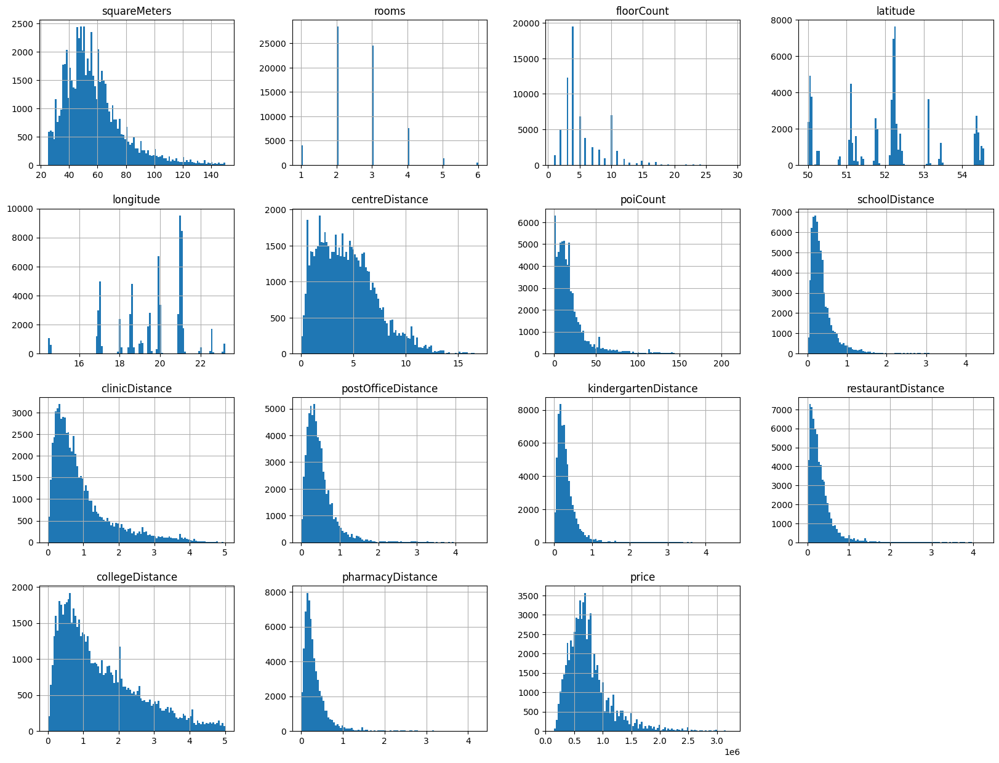

In [7]:
"""
Histograms.
"""

%matplotlib inline
data.hist(bins=100, figsize=(20,15))
plt.show()

In [8]:
"""
Locations on map.
This kind of map is loading quite long, but I think its worth it.
"""

locations = list(zip(data['latitude'], data['longitude']))
m = folium.Map(
    location=[np.mean(data['latitude']), np.mean(data['longitude'])],
    zoom_start=6
)
 
marker_cluster = MarkerCluster(locations=locations)
marker_cluster.add_to(m)
m

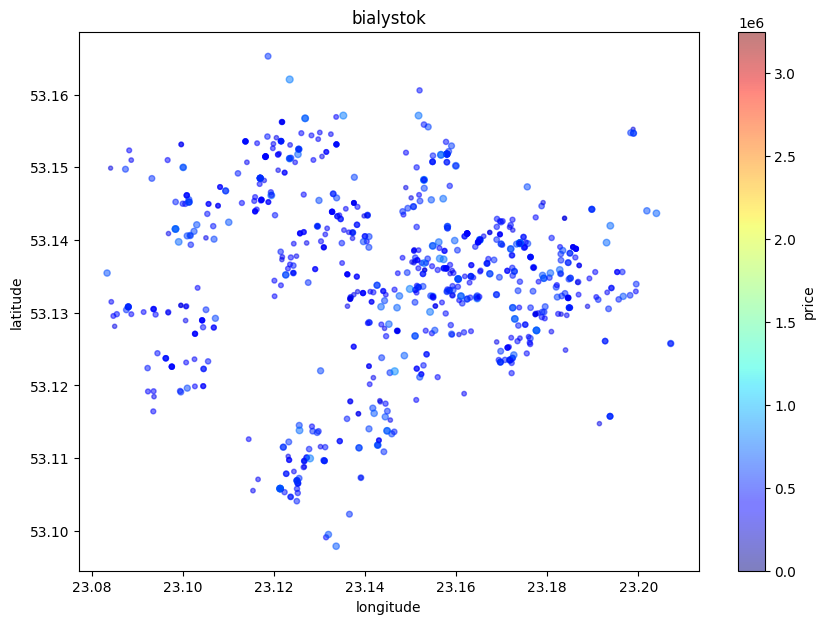

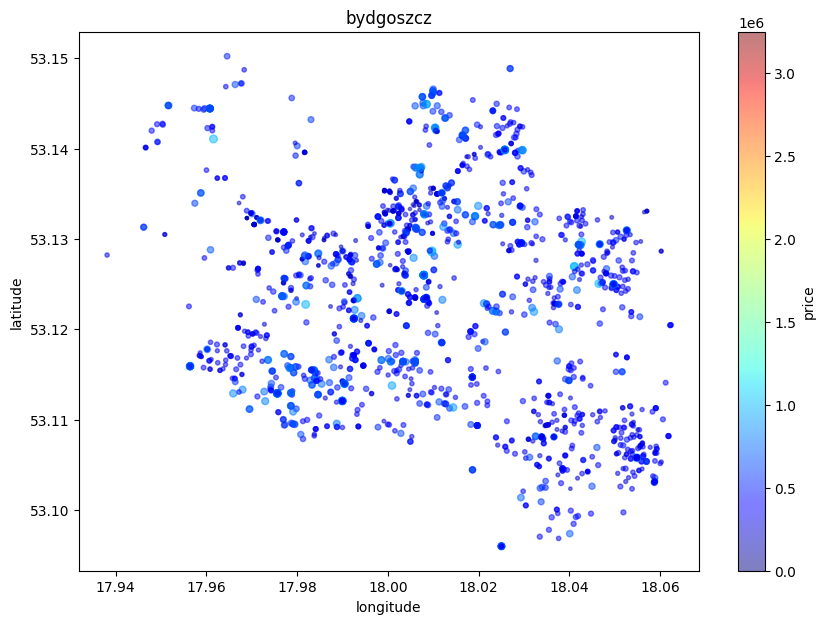

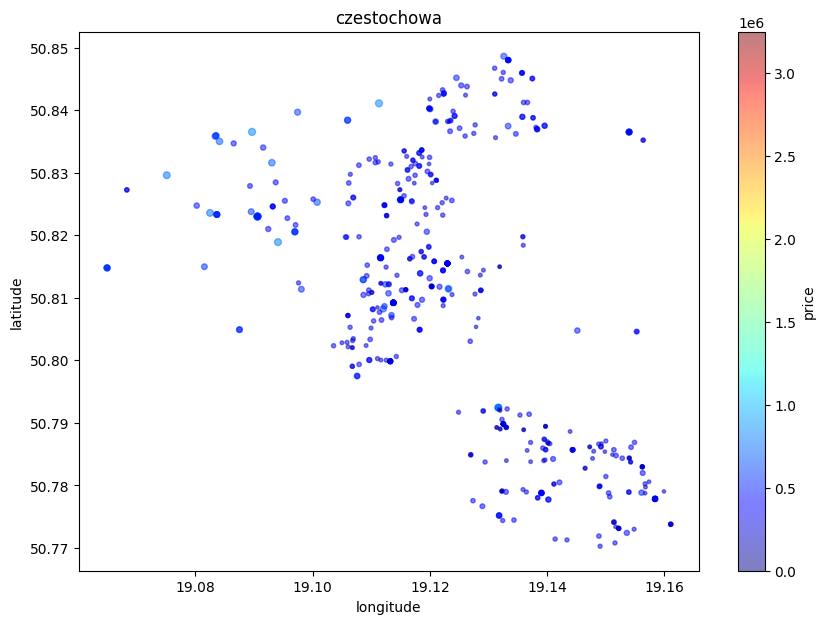

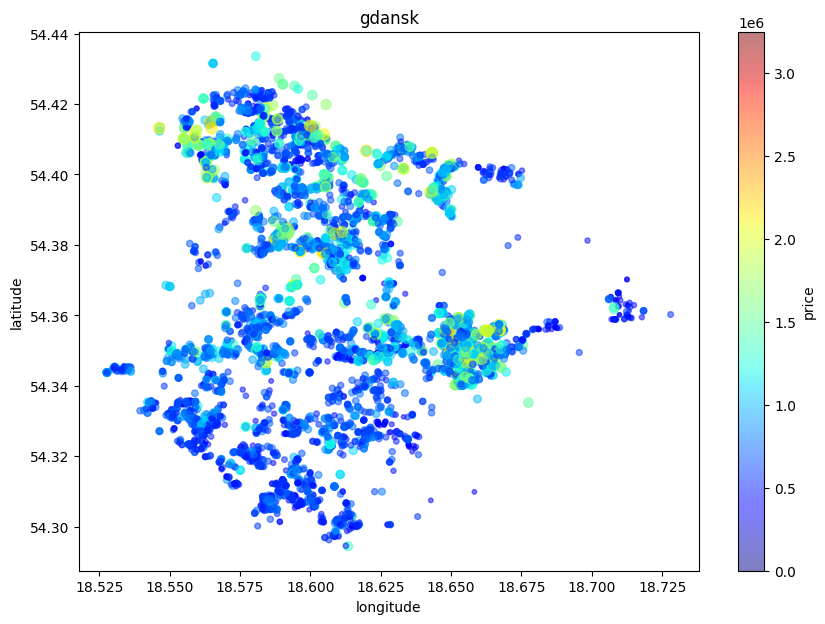

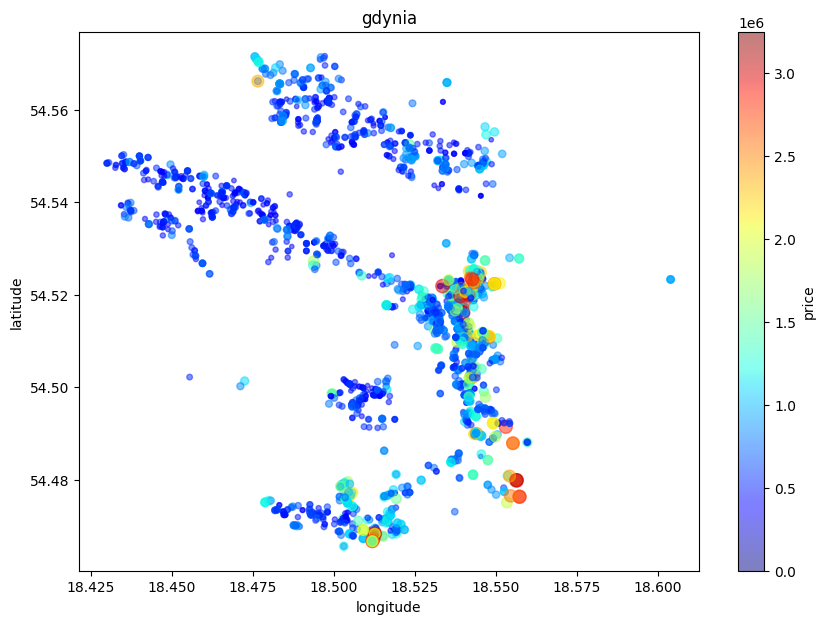

...

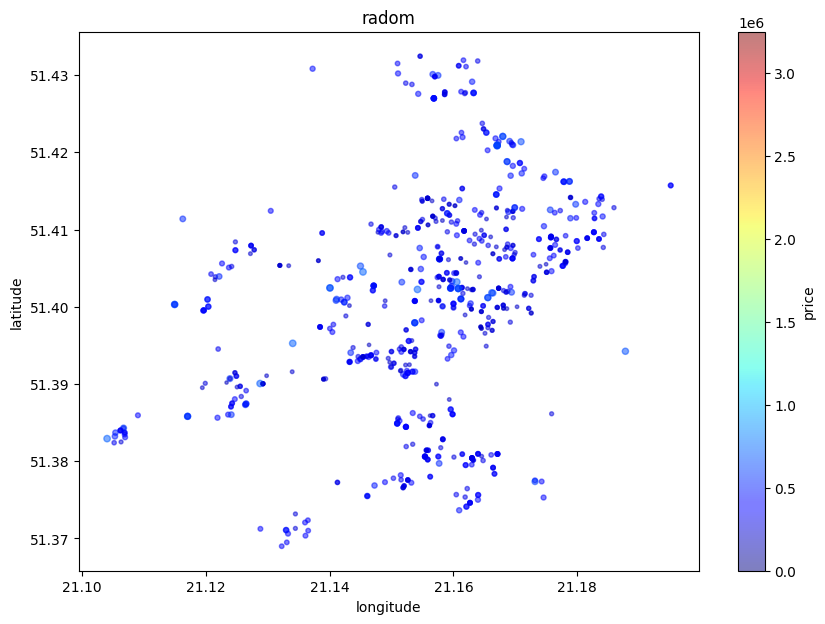

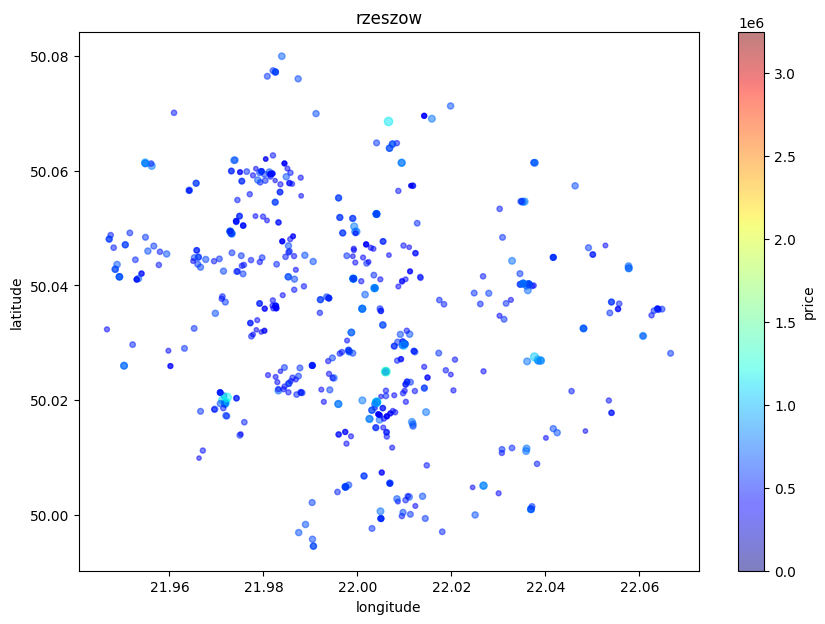

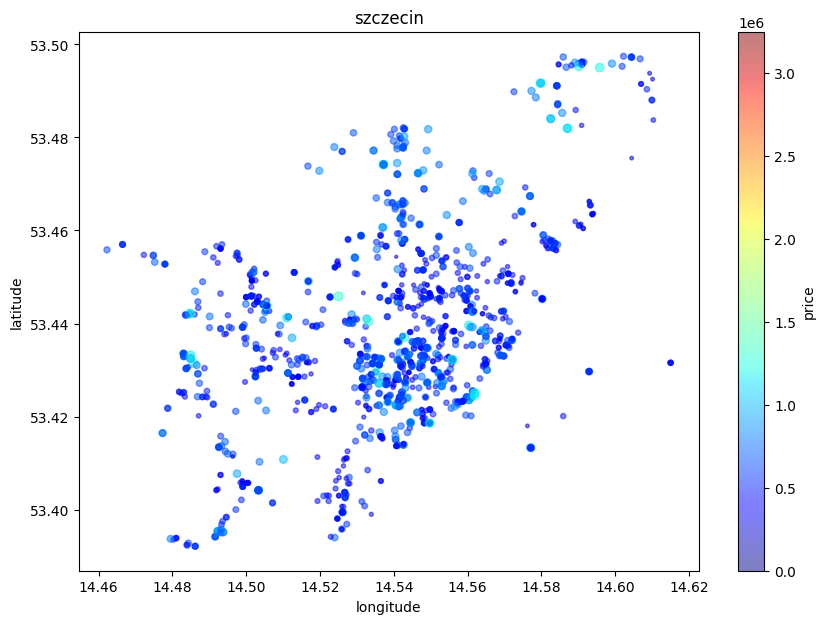

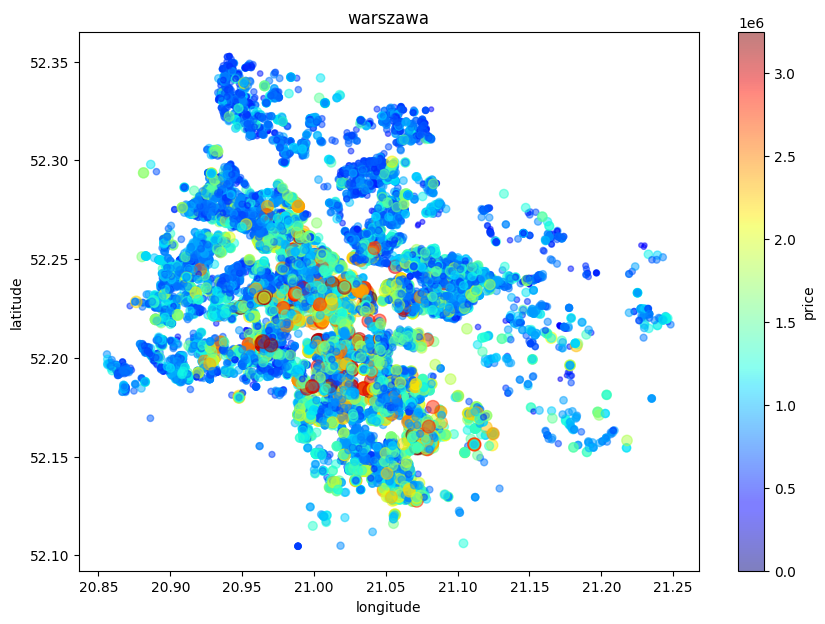

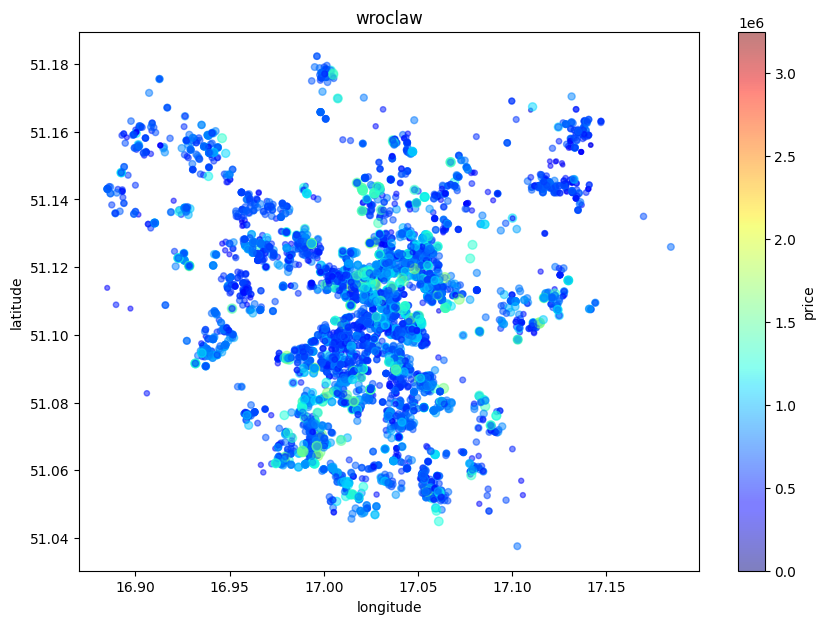

In [9]:
"""
Locations based on price.
"""

cities = np.unique(data['city'])
max_price = max(data['price'])
norm = Normalize(vmin=0, vmax=max_price)

for city in cities:
    subset = data[data['city'] == city]
    subset.plot(
        kind='scatter',
        x='longitude',
        y='latitude',
        title=city,
        alpha=0.5,
        s=100 * subset['price'] / max_price,
        figsize=(10, 7),
        c='price',
        norm=norm,
        cmap=plt.get_cmap('jet'),
        colorbar=True
    )

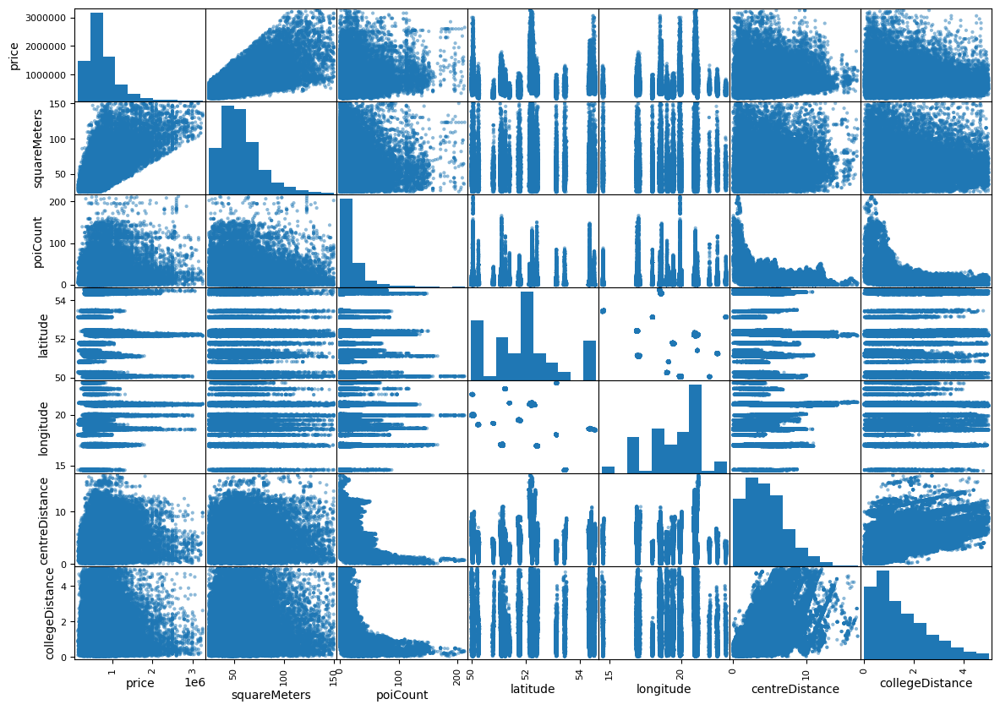

In [10]:
"""
Corelation matrix.
"""

%matplotlib inline
from pandas.plotting import scatter_matrix

attributes = ['price', 'squareMeters', 'poiCount', 'latitude', 'longitude', 'centreDistance', 'collegeDistance']
scatter_matrix(data[attributes], figsize=(14,10))
plt.show()

<AxesSubplot:>

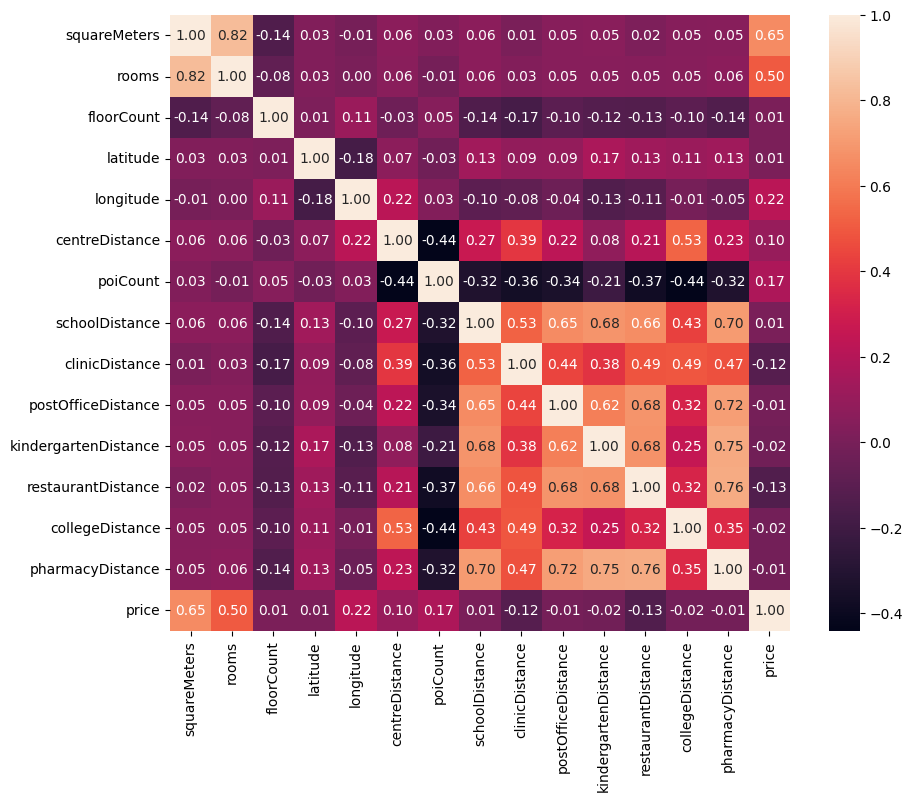

In [11]:
"""
Heatmap.
"""

plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(numeric_only=True), annot=True, fmt = '.2f')

### 4. Split and build data

In [12]:
"""
One-hot coding for cities.
"""

city_dummies = pd.get_dummies(data['city'])
data = data.drop('city', axis=1)
data = pd.concat([data, city_dummies], axis=1)

In [13]:
"""
Exclude non-numeric columns.
"""
numerical_columns = data.select_dtypes(include=['number']).columns
data = data[numerical_columns]

In [14]:
"""
Split data to X and y.
"""

test_ratio = 0.2 # 20% of amount is test data
y = data['price']
X = data.drop(columns=['price'])
rand_val = random.randint(0, 111)
min_y = min(y)
max_y = max(y)
min_y

151200

In [15]:
"""
Choose interesting columns and normalize.
"""

# 14 features
scaler_14f = MinMaxScaler()

X_14f = pd.DataFrame(scaler_14f.fit_transform(X), index=X.index, columns=X.columns)

# 7 features
columns_7f = ['squareMeters', 'rooms', 'floorCount', 'latitude', 'longitude',
       'centreDistance', 'bialystok', 'bydgoszcz', 'czestochowa', 'gdansk',
       'gdynia', 'katowice', 'krakow', 'lodz', 'lublin', 'poznan', 'radom',
       'rzeszow', 'szczecin', 'warszawa', 'wroclaw']
X_7f = X[columns_7f].copy()
scaler_7f = MinMaxScaler()
X_7f = pd.DataFrame(scaler_7f.fit_transform(X_7f), index=X_7f.index, columns=X_7f.columns)

# 4 features
columns_4f = ['squareMeters', 'latitude', 'longitude', 'bialystok', 'bydgoszcz',
       'czestochowa', 'gdansk', 'gdynia', 'katowice', 'krakow', 'lodz',
       'lublin', 'poznan', 'radom', 'rzeszow', 'szczecin', 'warszawa',
       'wroclaw']
X_4f = X[columns_4f].copy()
scaler_4f = MinMaxScaler()
X_4f = pd.DataFrame(scaler_4f.fit_transform(X_4f), index=X_4f.index, columns=X_4f.columns)

# Normalize result
# scaler_y = MinMaxScaler()
# y = pd.DataFrame(scaler_y.fit_transform(np.array(y).reshape(-1, 1)), index=y.index, columns=['price'])['price']

In [16]:
"""
Check columns and data example.
"""

X_14f.head()

,squareMeters,rooms,floorCount,latitude,longitude,centreDistance,poiCount,schoolDistance,clinicDistance,postOfficeDistance,...,katowice,krakow,lodz,lublin,poznan,radom,rzeszow,szczecin,warszawa,wroclaw
0,0.08800,0.2,0.321429,0.754018,0.011139,0.125887,0.075472,0.060626,0.098259,0.142016,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.38416,0.4,0.071429,0.756095,0.010412,0.190307,0.042453,0.061074,0.134281,0.079843,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.50080,0.4,0.071429,0.752364,0.008075,0.132979,0.150943,0.038702,0.051631,0.048429,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.32800,0.4,0.071429,0.746956,0.004726,0.239362,0.004717,0.048322,0.338003,0.109729,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.30640,0.4,0.107143,0.758465,0.012638,0.263593,0.047170,0.017226,0.244747,0.160558,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


### 5. Build models

We measure the models by coefficient of determination (R^2)
https://en.wikipedia.org/wiki/Coefficient_of_determination


R^2 factor: -0.035


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

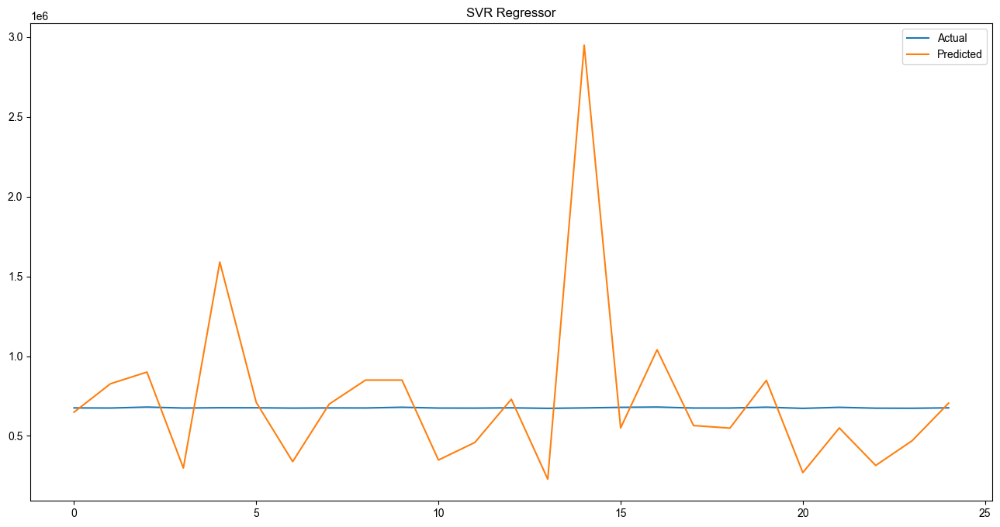

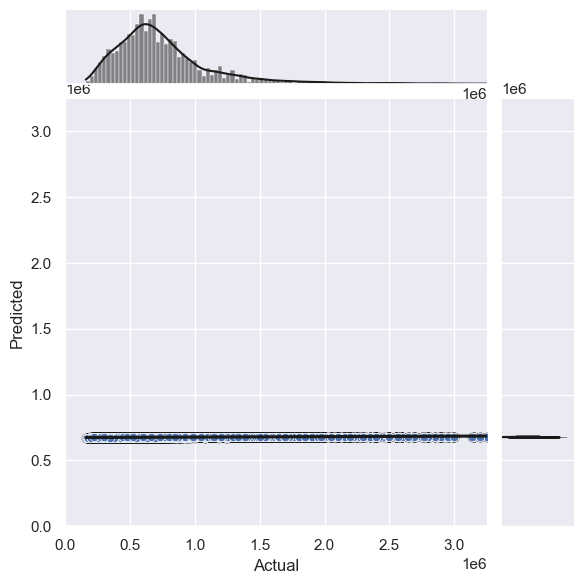

In [17]:
"""
Support vector machine regressor for every attribute (reg_svr_14f)
""" 

parameters={
    'kernel': 'rbf',
    'C': 1.0,
    'epsilon': 0.1,
    'gamma': 'scale'
}

reg_svr_14f = SVR(**parameters)

X_train, X_test, y_train, y_test = train_test_split(X_14f, y, test_size=test_ratio, random_state=rand_val)

reg_svr_14f.fit(X_train, y_train)
y_pred = reg_svr_14f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("SVR Regressor")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)


R^2 factor: 0.834


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

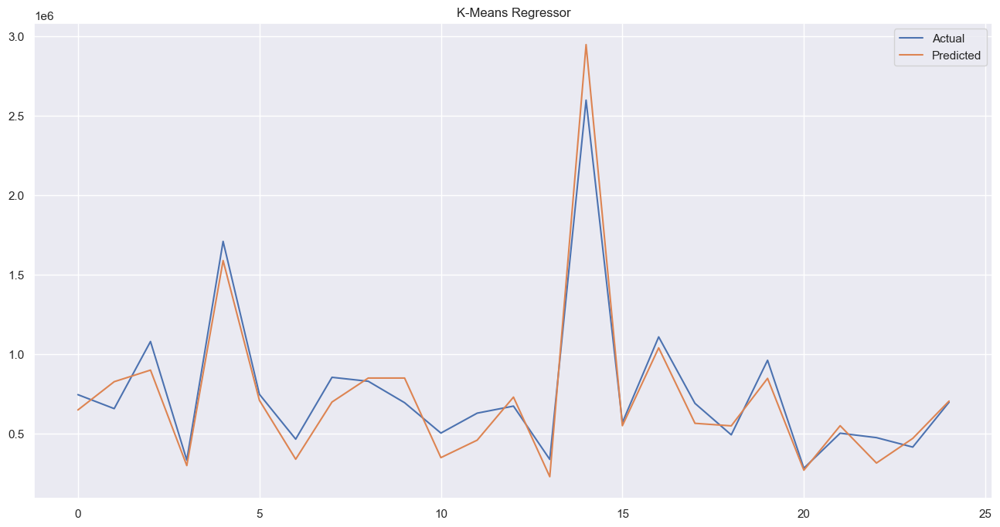

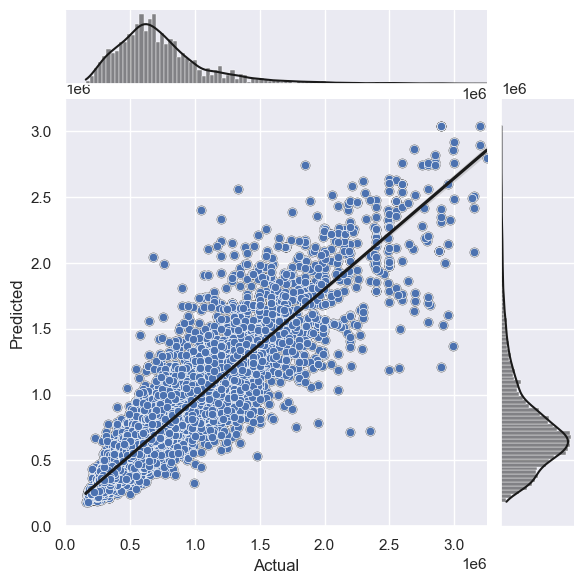

In [18]:
"""
K-Mean regressor for every attribute (reg_km_14f)
""" 

parameters={
    'n_neighbors': 5,
    'weights': 'uniform',
    'algorithm': 'auto',
    'leaf_size': 30,
    'p': 2,
    'metric': 'minkowski',
    'metric_params': None,
    'n_jobs': None,
}

reg_km_14f = KNeighborsRegressor(**parameters)

X_train, X_test, y_train, y_test = train_test_split(X_14f, y, test_size=test_ratio, random_state=rand_val)

reg_km_14f.fit(X_train, y_train)
y_pred = reg_km_14f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("K-Means Regressor")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)


R^2 factor: 0.785


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

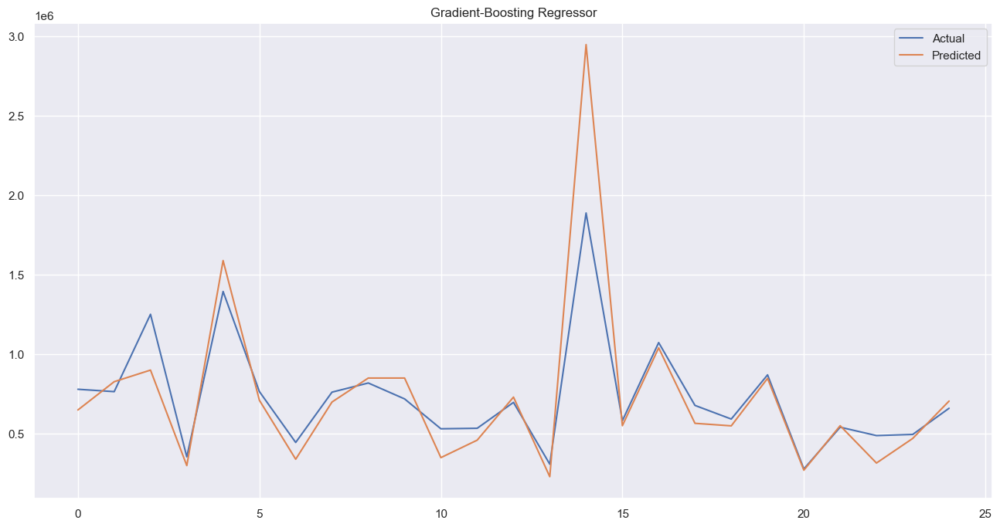

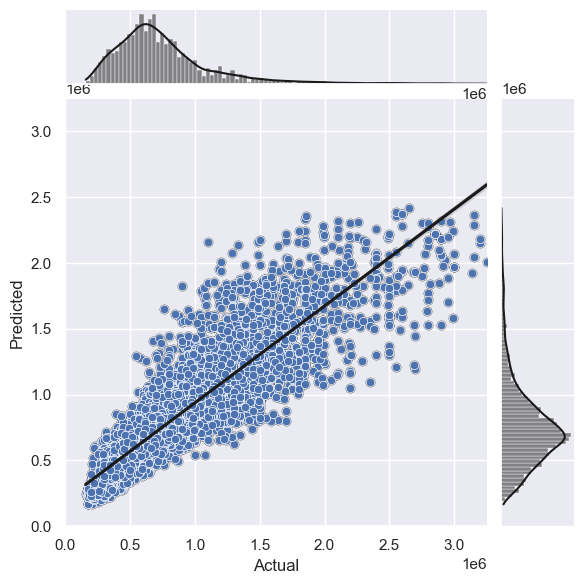

In [19]:
"""
Gradient boosting regressor for every attribute (reg_gb_14f)
""" 

parameters={
    'loss': 'squared_error',
    'learning_rate': 0.1,
    'n_estimators': 100,
    'subsample': 1.0,
    'criterion': 'friedman_mse',
    'min_samples_split': 2,
    'min_samples_leaf': 1,
    'max_depth': 3,
    'max_features': None,
    'alpha': 0.9
}

reg_gb_14f = GradientBoostingRegressor(**parameters)

X_train, X_test, y_train, y_test = train_test_split(X_14f, y, test_size=test_ratio, random_state=rand_val)

reg_gb_14f.fit(X_train, y_train)
y_pred = reg_gb_14f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.legend(['Actual','Predicted'])
plt.title("Gradient-Boosting Regressor")
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)


R^2 factor: 0.859


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

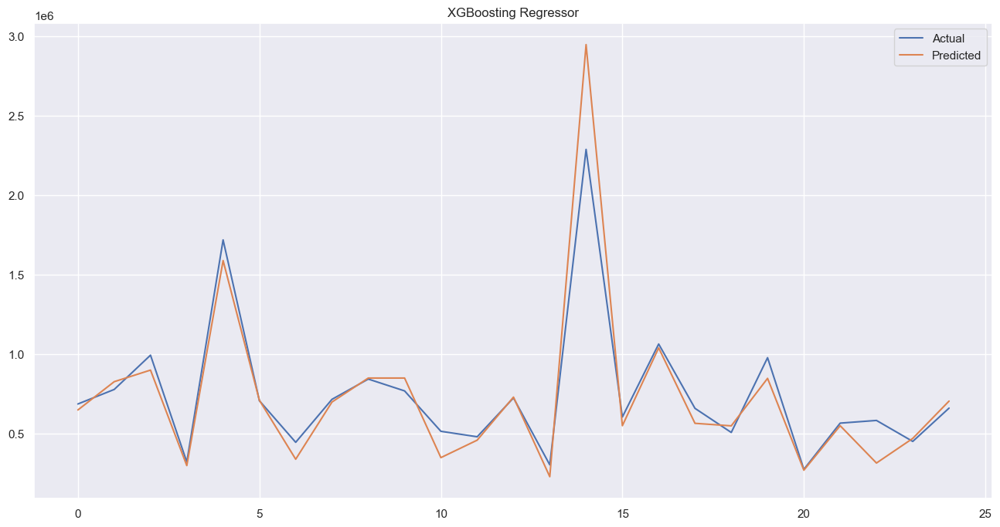

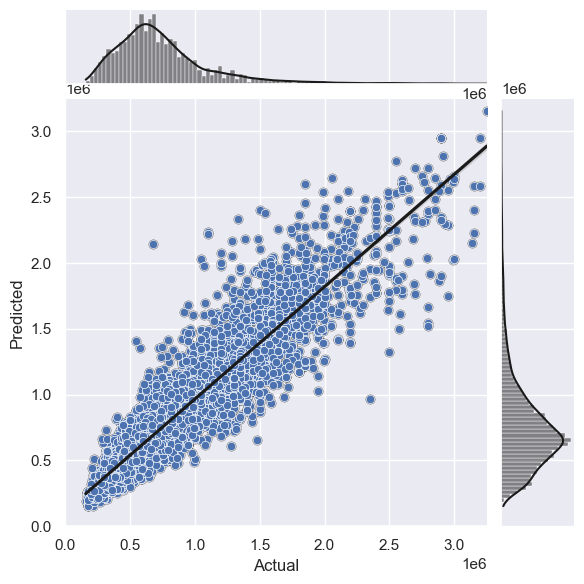

In [20]:
"""
XGBoosting regressor for every attribute (reg_xgb_14f)
""" 

parameters={
    'booster': 'gbtree',
    'learning_rate': 0.1,
    'n_estimators': 100,
    'max_depth': 3,
    'min_child_weight': 1,
    'subsample': 1,
    'colsample_bytree': 1,
    'gamma': 0,
    'reg_alpha': 0,
    'reg_lambda': 1,
    'objective': 'binary:logistic',
    'n_jobs': 1,
    'nthread': None,
    'max_delta_step': 0,
    'colsample_bytree': 1,
    'colsample_bylevel': 1,
    'scale_pos_weight': 1,
    'base_score': 0.5,
    'random_state': 0,
    'seed': None
}

reg_xgb_14f = xgb.XGBRegressor()

X_train, X_test, y_train, y_test = train_test_split(X_14f, y, test_size=test_ratio, random_state=rand_val)

reg_xgb_14f.fit(X_train, y_train)
y_pred = reg_xgb_14f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("XGBoosting Regressor")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best hiperparameters: {'n_estimators': 25, 'min_samples_split': 2, 'max_features': 0.75, 'max_depth': None, 'criterion': 'friedman_mse'}
Lowest MSE: -18124880349.51

R^2 factor: 0.887


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

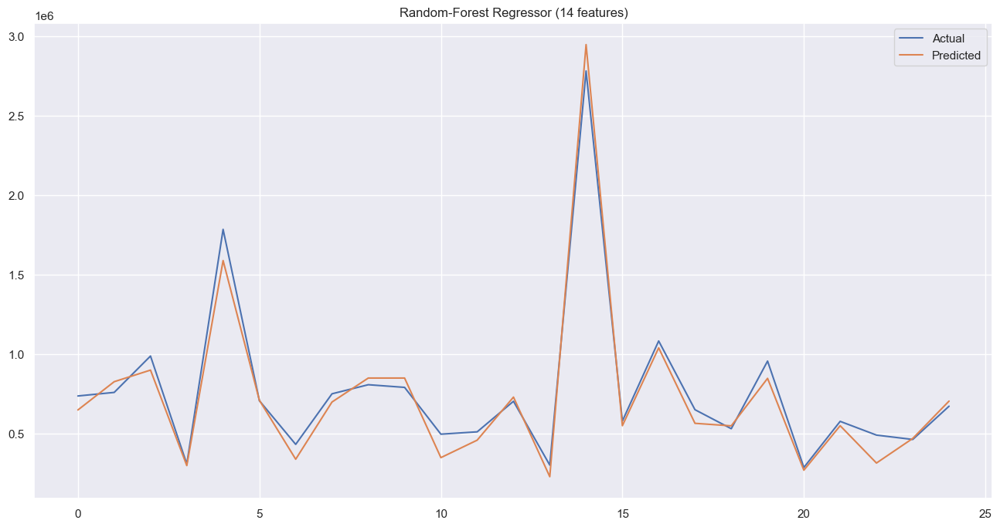

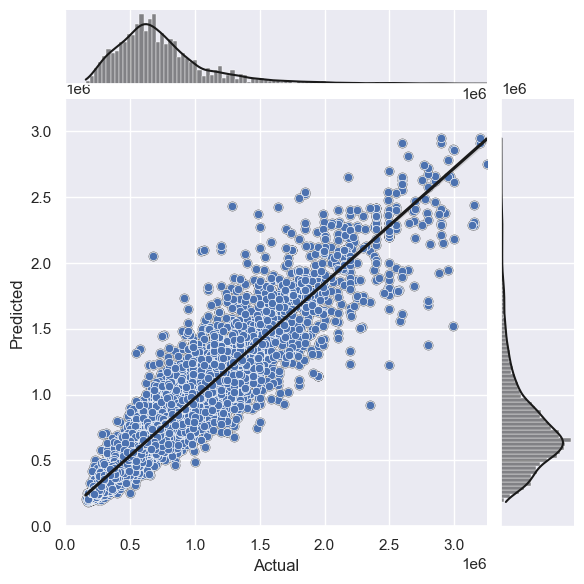

In [21]:
"""
Random forest regressor for every attribute (reg_rf_14f)

Default:
parameters={
    'n_estimators': 100,
    'criterion': 'mse',
    'max_depth': None,
    'min_samples_split': 2,
    'min_samples_leaf': 1,
    'max_features': 'auto',
    'bootstrap': True
}
""" 

parameters={
    'max_depth': [None, 5, 10, 15],
    'n_estimators': [10, 25, 50, 100],
    'criterion':['squared_error', 'poisson', 'friedman_mse'],
    'min_samples_split': [2, 4, 8],
    'min_samples_split': [2, 3],
    'max_features': [0.5, 0.75, 1.0]
}

rf_reg = RandomForestRegressor()
reg = RandomizedSearchCV(
    estimator=rf_reg,
    param_distributions=parameters,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=2
)

X_train, X_test, y_train, y_test = train_test_split(X_14f, y, test_size=test_ratio, random_state=rand_val)

reg.fit(X_train, y_train)
print("Best hiperparameters: " + str(reg.best_params_))
print("Lowest MSE: "+ "{:.2f}".format(reg.best_score_))

reg_rf_14f = RandomForestRegressor(**reg.best_params_)
reg_rf_14f.fit(X_train, y_train)
y_pred = reg_rf_14f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("Random-Forest Regressor (14 features)")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best hiperparameters: {'n_estimators': 25, 'min_samples_split': 2, 'max_features': 0.75, 'max_depth': None, 'criterion': 'friedman_mse'}
Lowest MSE: -17333061564.06

R^2 factor: 0.892


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

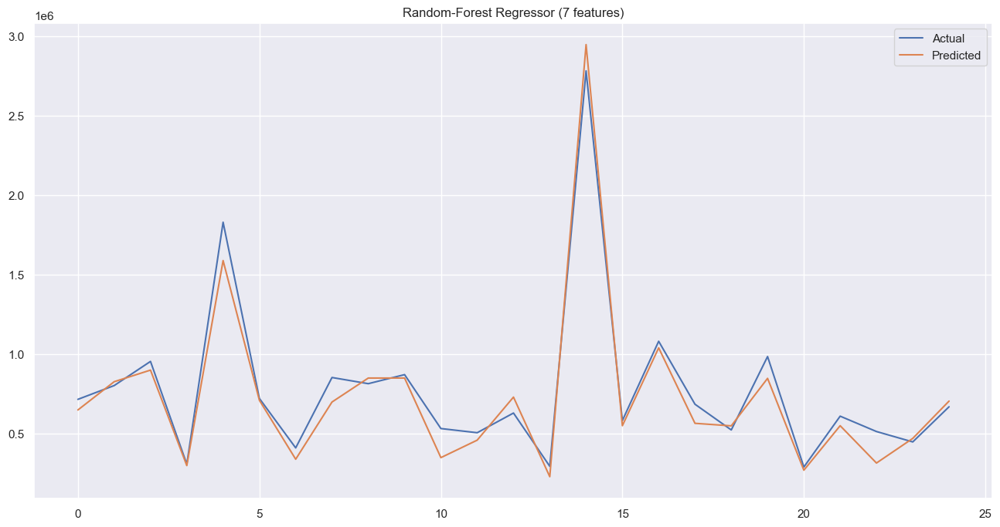

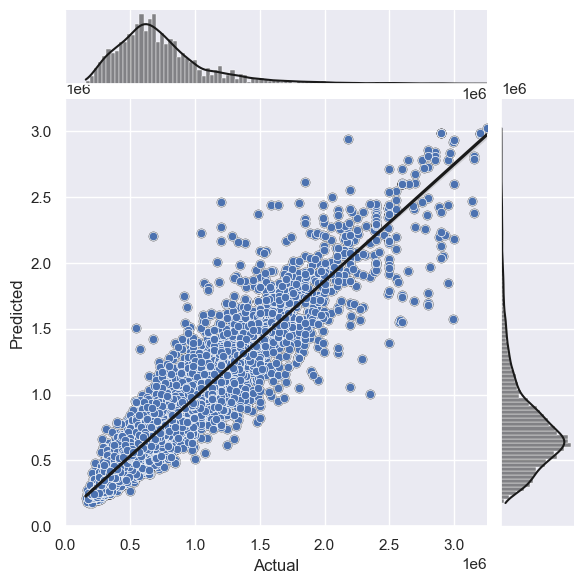

In [22]:
"""
Random forest regressor for 7 features (reg_rf_7f)
""" 

parameters={
    'max_depth': [None, 5, 10, 15],
    'n_estimators': [10, 25, 50, 100],
    'criterion':['squared_error', 'poisson', 'friedman_mse'],
    'min_samples_split': [2, 4, 8],
    'min_samples_split': [2, 3],
    'max_features': [0.5, 0.75, 1.0]
}

rf_reg = RandomForestRegressor()
reg = RandomizedSearchCV(
    estimator=rf_reg,
    param_distributions=parameters,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=2
)

X_train, X_test, y_train, y_test = train_test_split(X_7f, y, test_size=test_ratio, random_state=rand_val)

reg.fit(X_train, y_train)
print("Best hiperparameters: " + str(reg.best_params_))
print("Lowest MSE: "+ "{:.2f}".format(reg.best_score_))

reg_rf_7f = RandomForestRegressor(**reg.best_params_)
reg_rf_7f.fit(X_train, y_train)
y_pred = reg_rf_7f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("Random-Forest Regressor (7 features)")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best hiperparameters: {'n_estimators': 100, 'min_samples_split': 3, 'max_features': 0.5, 'max_depth': None, 'criterion': 'friedman_mse'}
Lowest MSE: -18314748044.38

R^2 factor: 0.883


<AxesSubplot:xlabel='Actual', ylabel='Predicted'>

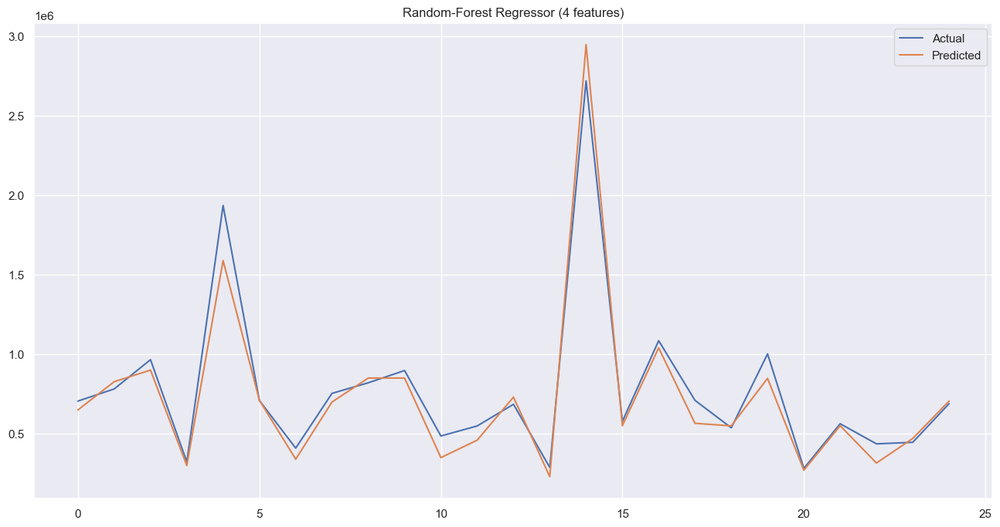

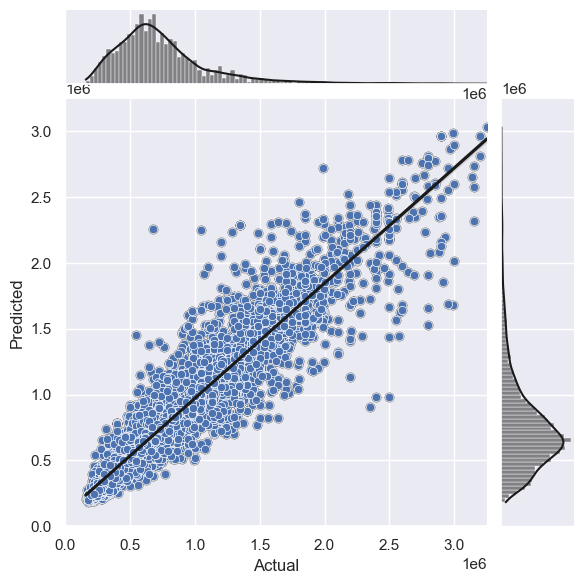

In [23]:
"""
Random forest regressor for 4 features (reg_rf_4f)
""" 

parameters={
    'max_depth': [None, 5, 10, 15],
    'n_estimators': [10, 25, 50, 100],
    'criterion':['squared_error', 'poisson', 'friedman_mse'],
    'min_samples_split': [2, 4, 8],
    'min_samples_split': [2, 3],
    'max_features': [0.5, 0.75, 1.0]
}

rf_reg = RandomForestRegressor()
reg = RandomizedSearchCV(
    estimator=rf_reg,
    param_distributions=parameters,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=2
)

X_train, X_test, y_train, y_test = train_test_split(X_4f, y, test_size=test_ratio, random_state=rand_val)

reg.fit(X_train, y_train)
print("Best hiperparameters: " + str(reg.best_params_))
print("Lowest MSE: "+ "{:.2f}".format(reg.best_score_))

reg_rf_4f = RandomForestRegressor(**reg.best_params_)
reg_rf_4f.fit(X_train, y_train)
y_pred = reg_rf_4f.predict(X_test)
print("\nR^2 factor: " + "{:.3f}".format(r2_score(y_test, y_pred)))

y_diff = pd.DataFrame({'Predicted':y_pred,'Actual':y_test})
fig = plt.figure(figsize=(16,8))
y_diff = y_diff.reset_index()
y_diff = y_diff.drop(['index'],axis=1)
plt.plot(y_diff[:25])
plt.title("Random-Forest Regressor (4 features)")
plt.legend(['Actual','Predicted'])
sns.set(style='darkgrid')
jplot = sns.jointplot(
    xlim=(0, max_y),
    ylim=(0, max_y),
    x='Actual',
    y='Predicted',
    data=y_diff,
    kind='reg',
    color='k'
);
sns.scatterplot(
    data=y_diff,
    x='Actual',
    y='Predicted',
    ax=jplot.ax_joint,
)

### 6. Export model to PMML

In [25]:
from sklearn2pmml import PMMLPipeline
from sklearn2pmml import sklearn2pmml
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer

    
pipeline_14f = PMMLPipeline([
    ("scaler", scaler_14f),
    ("estimator", reg_rf_14f)
])
sklearn2pmml(pipeline_14f, "reg_rf_14f.pmml", with_repr=True)

pipeline_7f = PMMLPipeline([
    ("scaler", scaler_7f),
    ("estimator", reg_rf_7f)
])
sklearn2pmml(pipeline_7f, "reg_rf_7f.pmml", with_repr=True)

pipeline_4f = PMMLPipeline([
    ('scaler', scaler_4f),
    ('estimator', reg_rf_4f)
])
sklearn2pmml(pipeline_4f, "reg_rf_4f.pmml", with_repr=True)

### 7. Tests

In [44]:
test_vector = [25, 22, 25, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
df = pd.DataFrame([test_vector], columns=list(X_train.keys()))
test_y = pipeline.predict([test_vector])[0]
test_y

C:\Users\dgajd\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
C:\Users\dgajd\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


375127.5014285715

### 8. Data required for every model

In [30]:
print("Data for 14-features")
print(list(X_train.keys()))

print("\nData for 7-features")
print(columns_7f)

print("\nData for 4-features")
print(columns_4f)

# Sprawdzić przy jakich cechach modele odstają


Data for 14-features
['squareMeters', 'latitude', 'longitude', 'bialystok', 'bydgoszcz', 'czestochowa', 'gdansk', 'gdynia', 'katowice', 'krakow', 'lodz', 'lublin', 'poznan', 'radom', 'rzeszow', 'szczecin', 'warszawa', 'wroclaw']

Data for 7-features
['squareMeters', 'rooms', 'floorCount', 'latitude', 'longitude', 'centreDistance', 'bialystok', 'bydgoszcz', 'czestochowa', 'gdansk', 'gdynia', 'katowice', 'krakow', 'lodz', 'lublin', 'poznan', 'radom', 'rzeszow', 'szczecin', 'warszawa', 'wroclaw']

Data for 4-features
['squareMeters', 'latitude', 'longitude', 'bialystok', 'bydgoszcz', 'czestochowa', 'gdansk', 'gdynia', 'katowice', 'krakow', 'lodz', 'lublin', 'poznan', 'radom', 'rzeszow', 'szczecin', 'warszawa', 'wroclaw']
